## DS203 - Project

In [10]:
!git clone https://github.com/Harshvardhan-10/DS203_Project

fatal: destination path 'DS203_Project' already exists and is not an empty directory.


In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [13]:
!pip install librosa soundfile --quiet

import librosa
import librosa.display
import soundfile as sf
import IPython.display as ipd

In [16]:
from sklearn.preprocessing import MinMaxScaler

In [64]:
path = 'DS203_Project/MFCC-files'

data = pd.read_csv(path+'/01-MFCC.csv')

In [65]:
def show_data(data):
    plt.figure()
    plt.title("data")
    plt.plot(data)
    plt.show()

In [66]:
# Load the MFCC data from the CSV file
mfccs = np.loadtxt(path+'/01-MFCC.csv', delimiter=',')

before transform  [-633.6741  -633.6741  -633.6741  -633.61255 -632.8865  -633.461
 -623.6366  -566.94525 -568.5442  -623.7093 ]


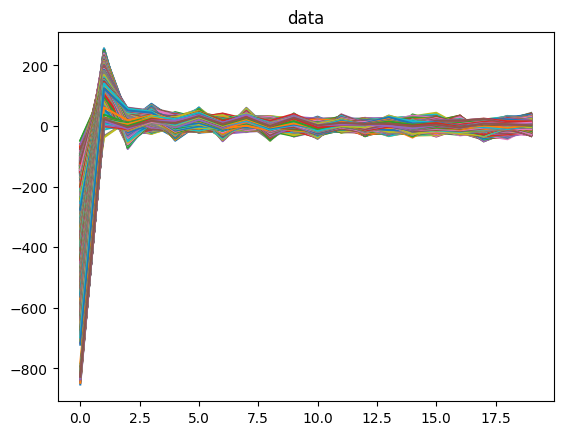

mfcc shape  (20, 9866)


In [67]:
data = mfccs
print('before transform ', data[0][:10])
# scaler = MinMaxScaler(feature_range=(0, 1))
# scaler = scaler.fit(data)
# data = scaler.transform(data)

show_data(data)
print('mfcc shape ', data.shape)

In [68]:
# data = scaler.inverse_transform(data)

# print('after inverse transform ', data[0][:10])

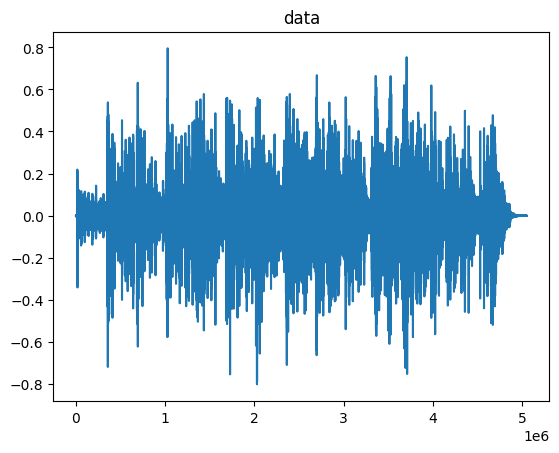

In [69]:
wav = librosa.feature.inverse.mfcc_to_audio(data[:][:325])
show_data(wav)
ipd.Audio(wav, rate=44100)

In [73]:
ipd.Audio(wav, rate=176400)

MFCC Shape: (20, 9866)
Number of MFCC coefficients: 20
Number of time frames: 9866
Approximate duration: 114.54 seconds


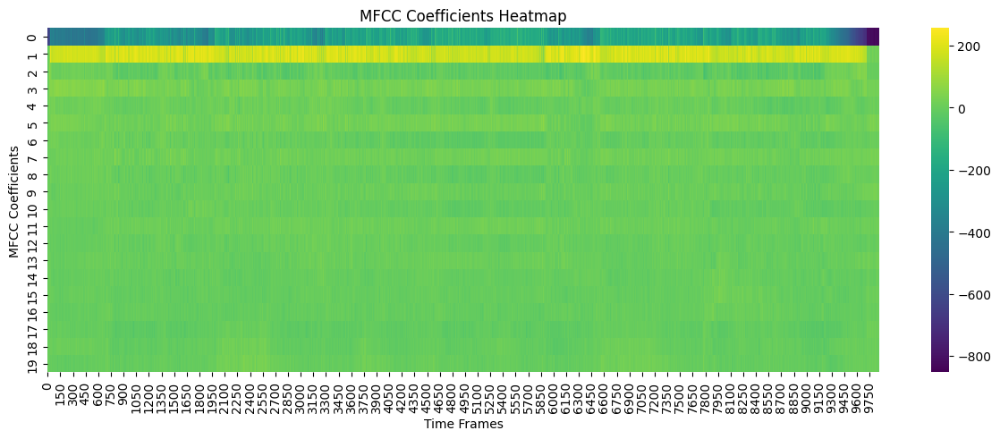

In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def read_and_visualize_mfcc(file_path):
    # Read the MFCC CSV file
    mfcc_data = pd.read_csv(file_path, header=None)

    # Print basic information about the MFCC data
    print(f"MFCC Shape: {mfcc_data.shape}")
    print(f"Number of MFCC coefficients: {mfcc_data.shape[0]}")
    print(f"Number of time frames: {mfcc_data.shape[1]}")

    # Calculate approximate duration of the audio
    hop_size = 512
    sample_rate = 44100
    duration_seconds = (mfcc_data.shape[1] * hop_size) / sample_rate
    print(f"Approximate duration: {duration_seconds:.2f} seconds")

    # Create a heatmap visualization of the MFCC coefficients
    plt.figure(figsize=(15, 5))
    sns.heatmap(mfcc_data, cmap='viridis')
    plt.title('MFCC Coefficients Heatmap')
    plt.xlabel('Time Frames')
    plt.ylabel('MFCC Coefficients')
    plt.show()

    return mfcc_data

# Example usage:
mfcc_data = read_and_visualize_mfcc(path+'/01-MFCC.csv')

<ipython-input-58-7677f46a7b39>:2: UserWarning: PySoundFile failed. Trying audioread instead.
  data, rate = librosa.load("ojas_test.mp3")
/usr/local/lib/python3.10/dist-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


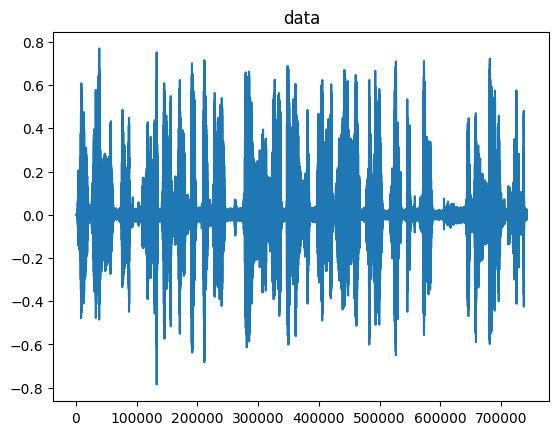

In [58]:
# load a sample
data, rate = librosa.load("ojas_test.mp3")

def show_data(data):
    plt.figure()
    plt.title("data")
    plt.plot(data)
    plt.show()

show_data(data)
ipd.Audio(data, rate=22050)

In [59]:
data = np.array(data)
data.shape

(742468,)

before transform  [-536.73846 -536.73846 -536.73846 -536.73846 -511.5051  -407.44568
 -310.09964 -246.88406 -230.3083  -224.79553]


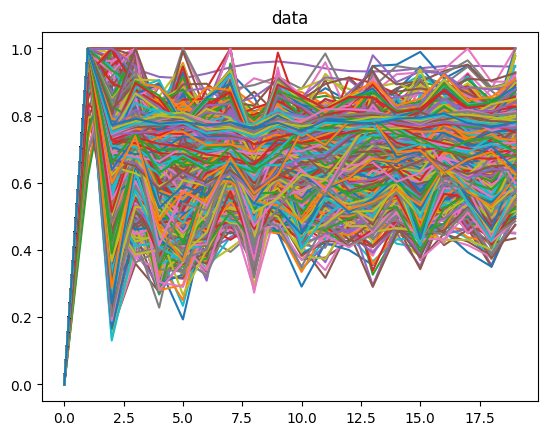

mfcc shape  (20, 1451)


In [60]:
data = librosa.feature.mfcc(y=data, sr=44100, n_mfcc=20)

pd.DataFrame(data).to_csv('ojas_mfcc.csv')

print('before transform ', data[0][:10])
scaler = MinMaxScaler(feature_range=(0, 1))
scaler = scaler.fit(data)
data = scaler.transform(data)

show_data(data)
print('mfcc shape ', data.shape)

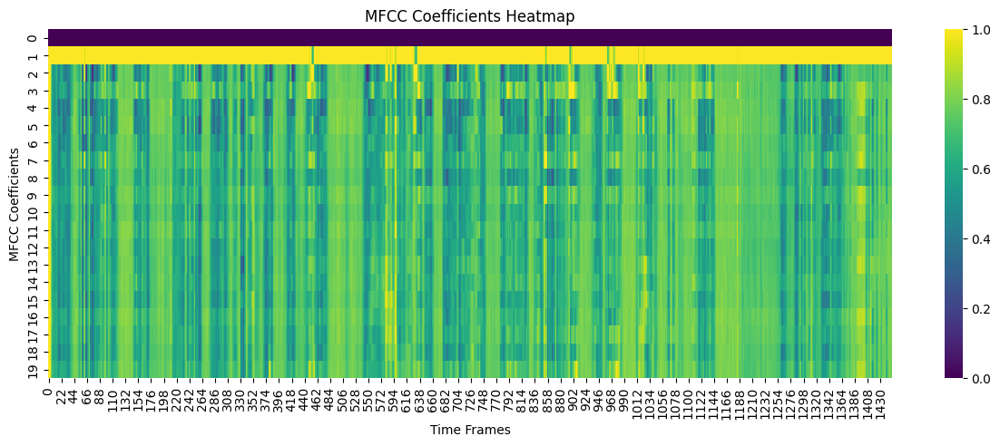

In [61]:
plt.figure(figsize=(15, 5))
sns.heatmap(data, cmap='viridis')
plt.title('MFCC Coefficients Heatmap')
plt.xlabel('Time Frames')
plt.ylabel('MFCC Coefficients')
plt.show()

after inverse transform  [-536.73846 -536.73846 -536.73846 -536.73846 -511.5051  -407.44568
 -310.09964 -246.88406 -230.3083  -224.79553]


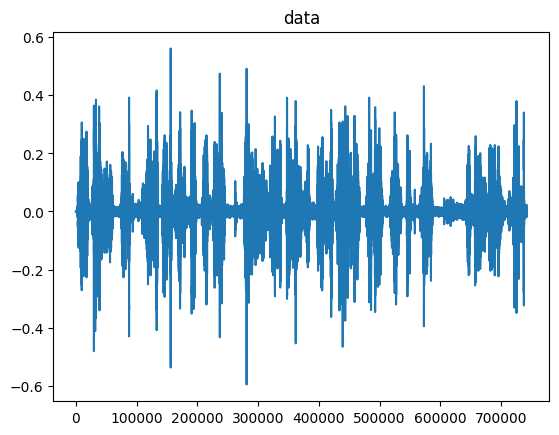

In [62]:
data = scaler.inverse_transform(data)

print('after inverse transform ', data[0][:10])

wav = librosa.feature.inverse.mfcc_to_audio(data)
show_data(wav)


In [63]:
ipd.Audio(wav, rate=22050)

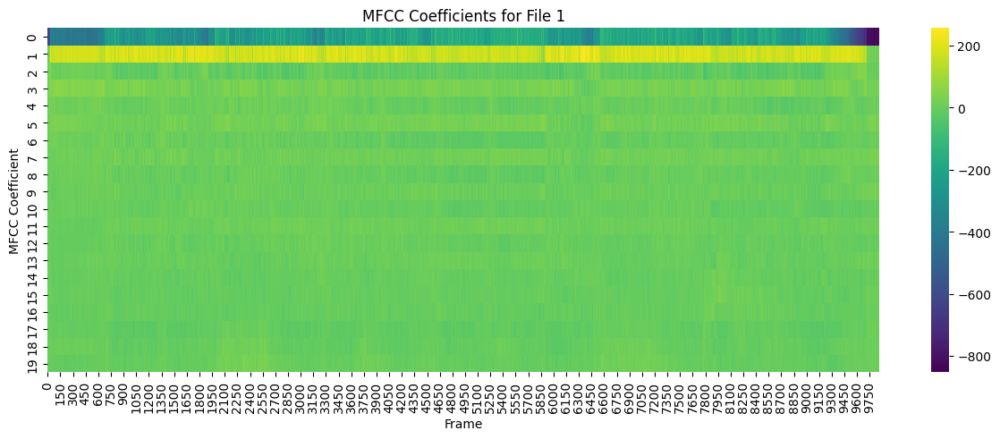

Features extracted for file 1:
mean: Shape (20,)
std: Shape (20,)
max: Shape (20,)
min: Shape (20,)
median: Shape (20,)


In [74]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import glob
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

class MFCCAnalyzer:
    def __init__(self, data_directory):
        """
        Initialize the MFCC analyzer with the directory containing MFCC CSV files

        Parameters:
        data_directory (str): Path to directory containing MFCC CSV files
        """
        self.data_directory = Path(data_directory)
        self.mfcc_files = {}
        self.features = {}

    def load_mfcc_file(self, file_number):
        """
        Load a single MFCC file

        Parameters:
        file_number (int): The number of the MFCC file to load

        Returns:
        numpy.ndarray: The loaded MFCC data
        """
        if file_number < 100:
          file_path = self.data_directory / f"{file_number:02d}-MFCC.csv"
        else:
          file_path = self.data_directory / f"{file_number:03d}-MFCC.csv"
        try:
            mfcc_data = pd.read_csv(file_path, header=None).values
            self.mfcc_files[file_number] = mfcc_data
            return mfcc_data
        except FileNotFoundError:
            print(f"File {file_path} not found")
            return None

    def load_all_files(self):
        """Load all MFCC files from the directory"""
        pattern = str(self.data_directory / "*-MFCC.csv")
        for file_path in glob.glob(pattern):
            file_number = int(Path(file_path).stem.split('-')[0])
            self.load_mfcc_file(file_number)

    def visualize_mfcc(self, file_number):
        """
        Visualize MFCC coefficients for a single file

        Parameters:
        file_number (int): The number of the MFCC file to visualize
        """
        if file_number not in self.mfcc_files:
            self.load_mfcc_file(file_number)

        if file_number in self.mfcc_files:
            plt.figure(figsize=(15, 5))
            sns.heatmap(self.mfcc_files[file_number], cmap='viridis')
            plt.title(f'MFCC Coefficients for File {file_number}')
            plt.xlabel('Frame')
            plt.ylabel('MFCC Coefficient')
            plt.show()

    def extract_features(self, file_number):
        """
        Extract statistical features from MFCC data

        Parameters:
        file_number (int): The number of the MFCC file to analyze

        Returns:
        dict: Dictionary containing extracted features
        """
        if file_number not in self.mfcc_files:
            self.load_mfcc_file(file_number)

        if file_number in self.mfcc_files:
            mfcc_data = self.mfcc_files[file_number]
            features = {
                'mean': np.mean(mfcc_data, axis=1),
                'std': np.std(mfcc_data, axis=1),
                'max': np.max(mfcc_data, axis=1),
                'min': np.min(mfcc_data, axis=1),
                'median': np.median(mfcc_data, axis=1)
            }
            self.features[file_number] = features
            return features
        return None

# Example usage
if __name__ == "__main__":
    # Initialize analyzer (replace with your actual directory path)
    analyzer = MFCCAnalyzer(path)

    # Load and visualize a single file
    file_number = 1
    analyzer.load_mfcc_file(file_number)
    analyzer.visualize_mfcc(file_number)

    # Extract features
    features = analyzer.extract_features(file_number)
    if features:
        print(f"Features extracted for file {file_number}:")
        for feature_name, values in features.items():
            print(f"{feature_name}: Shape {values.shape}")

In [98]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import glob
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.stats import skew, kurtosis

class MFCCAnalyzer:
    def __init__(self, data_directory):
        self.data_directory = Path(data_directory)
        self.mfcc_files = {}
        self.features = {}
        self.feature_matrix = None
        self.pca_model = None

    def load_mfcc_file(self, file_number):
        """Previous load_mfcc_file implementation remains the same"""
        if file_number < 100:
          file_path = self.data_directory / f"{file_number:02d}-MFCC.csv"
        else:
          file_path = self.data_directory / f"{file_number:03d}-MFCC.csv"
        try:
            mfcc_data = pd.read_csv(file_path, header=None).values
            self.mfcc_files[file_number] = mfcc_data
            return mfcc_data
        except FileNotFoundError:
            print(f"File {file_path} not found")
            return None

    def extract_advanced_features(self, file_number):
        """
        Extract advanced statistical features from MFCC data
        """
        if file_number not in self.mfcc_files:
            self.load_mfcc_file(file_number)

        if file_number in self.mfcc_files:
            mfcc_data = self.mfcc_files[file_number]
            features = {
                'mean': np.mean(mfcc_data, axis=1),
                'std': np.std(mfcc_data, axis=1),
                'max': np.max(mfcc_data, axis=1),
                'min': np.min(mfcc_data, axis=1),
                'median': np.median(mfcc_data, axis=1),
                'skewness': skew(mfcc_data, axis=1),
                'kurtosis': kurtosis(mfcc_data, axis=1),
                'range': np.ptp(mfcc_data, axis=1),  # Peak-to-peak (range) values
                'q25': np.percentile(mfcc_data, 25, axis=1),  # First quartile
                'q75': np.percentile(mfcc_data, 75, axis=1)   # Third quartile
            }
            self.features[file_number] = features
            return features
        return None

    def build_feature_matrix(self):
        """
        Build a feature matrix for all loaded files
        """
        all_features = []
        file_numbers = []

        for file_num in self.mfcc_files.keys():
            features = self.extract_advanced_features(file_num)
            if features:
                # Flatten all features into a single vector
                feature_vector = np.concatenate([v for v in features.values()])
                all_features.append(feature_vector)
                file_numbers.append(file_num)

        self.feature_matrix = np.vstack(all_features)
        return self.feature_matrix, file_numbers

    def perform_clustering(self, n_clusters=6):
        """
        Perform clustering on the feature matrix
        """
        if self.feature_matrix is None:
            self.build_feature_matrix()

        # Standardize features
        scaler = StandardScaler()
        scaled_features = scaler.fit_transform(self.feature_matrix)

        # Reduce dimensionality with PCA
        self.pca_model = PCA(n_components=0.95)  # Preserve 95% of variance
        reduced_features = self.pca_model.fit_transform(scaled_features)

        # Perform K-means clustering
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        clusters = kmeans.fit_predict(reduced_features)

        # Calculate silhouette score
        silhouette_avg = silhouette_score(reduced_features, clusters)

        return clusters, silhouette_avg, reduced_features

    def analyze_song_groups(self):
        """
        Analyze and group songs based on their features
        """
        clusters, silhouette_avg, reduced_features = self.perform_clustering()

        # Create a visualization of the clusters
        plt.figure(figsize=(12, 8))
        scatter = plt.scatter(reduced_features[:, 0], reduced_features[:, 1],
                            c=clusters, cmap='viridis')
        plt.title('Song Clusters based on MFCC Features')
        plt.xlabel('First Principal Component')
        plt.ylabel('Second Principal Component')
        plt.colorbar(scatter)
        plt.show()

        # Return cluster assignments for each file
        return {file_num: cluster for file_num, cluster
                in zip(self.mfcc_files.keys(), clusters)}

    def find_similar_songs(self, reference_file_number, n_similar=18):
        """
        Find songs similar to a reference song
        """
        if self.feature_matrix is None:
            self.build_feature_matrix()

        reference_idx = list(self.mfcc_files.keys()).index(reference_file_number)
        reference_features = self.feature_matrix[reference_idx]

        # Calculate distances to all other songs
        distances = np.linalg.norm(self.feature_matrix - reference_features, axis=1)

        # Get indices of most similar songs (excluding the reference song)
        similar_indices = np.argsort(distances)[1:n_similar+1]

        # Return file numbers of similar songs
        file_numbers = list(self.mfcc_files.keys())
        return [file_numbers[idx] for idx in similar_indices]

    def visualize_anthem_characteristics(self, file_numbers):
      """
      Visualize characteristics of potential anthem files for comparison
      """
      features_list = []

      # Add debug information
      print(f"Attempting to analyze files: {file_numbers}")

      if not file_numbers:
          print("No files provided for visualization")
          return

      for file_num in file_numbers:
          if file_num not in self.mfcc_files:
              print(f"Loading file {file_num}...")
              self.load_mfcc_file(file_num)

          if file_num in self.mfcc_files:
              print(f"Analyzing features for file {file_num}")
              features = self.analyze_temporal_structure(file_num)
              features_list.append(features)
          else:
              print(f"Failed to load or analyze file {file_num}")

      if not features_list:
          print("No features were extracted from any files")
          return

      # Create a comparison plot
      fig, axes = plt.subplots(2, 2, figsize=(15, 10))
      feature_names = list(features_list[0].keys())

      for i, feature in enumerate(feature_names):
          row, col = i // 2, i % 2
          values = [f[feature] for f in features_list]
          axes[row, col].bar(file_numbers, values)
          axes[row, col].set_title(feature)
          axes[row, col].set_xlabel('File Number')

      plt.tight_layout()
      plt.show()

    def detect_anthems(self, duration_range=(40*86, 60*86)):
      """
      Detect potential national anthem files based on various characteristics
      Returns sorted list of (file_number, probability) tuples
      """
      anthem_scores = []

      # Print the number of files being analyzed
      print(f"Total files loaded: {len(self.mfcc_files)}")

      if not self.mfcc_files:
          print("No files loaded. Please load files first.")
          return []

      for file_num in self.mfcc_files.keys():
          print(f"Analyzing file {file_num}...")
          # Get temporal features
          temporal_features = self.analyze_temporal_structure(file_num)

          # Score calculation
          score = 0

          # Duration score
          duration = temporal_features['duration']
          if duration_range[0] <= duration <= duration_range[1]:
              score += 2
              print(f"File {file_num} got duration score")

          # Stability score
          if temporal_features['stability'] < 0.5:
              score += 2
              print(f"File {file_num} got stability score")

          # Tempo regularity score
          if temporal_features['tempo_regularity'] < 0.3:
              score += 2
              print(f"File {file_num} got tempo regularity score")

          # Repetition score
          if temporal_features['repetition'] > 0.7:
              score += 2
              print(f"File {file_num} got repetition score")

          anthem_scores.append((file_num, score))
          print(f"File {file_num} total score: {score}")

      # Sort by score in descending order
      # return sorted(anthem_scores, key=lambda x: x[1], reverse=True)
      return anthem_scores

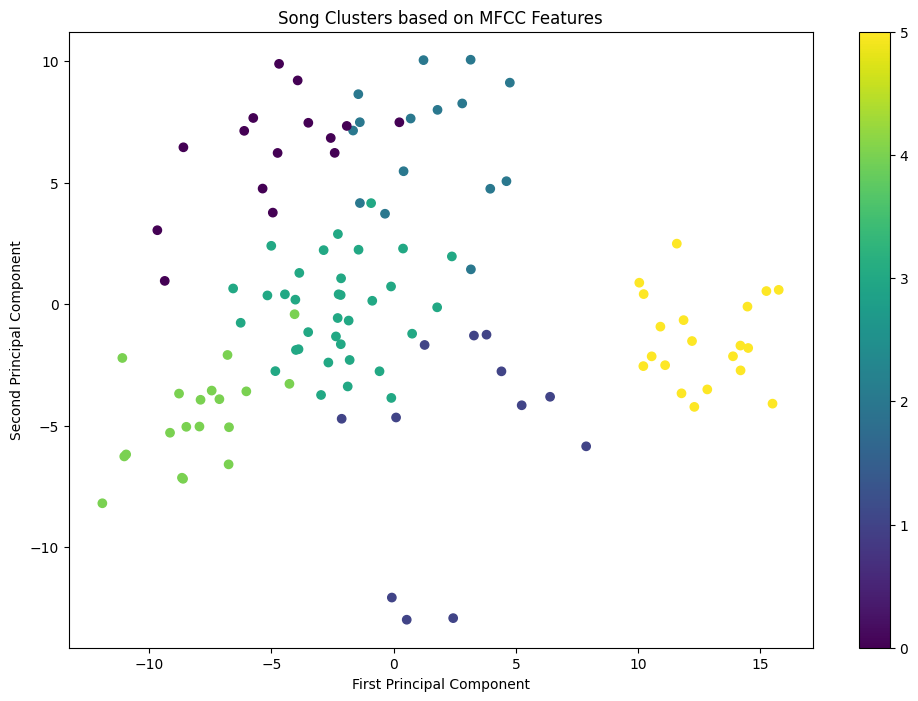


Cluster assignments: {1: 2, 2: 2, 3: 0, 4: 0, 5: 5, 6: 3, 7: 1, 8: 0, 9: 5, 10: 4, 11: 3, 12: 0, 13: 4, 14: 3, 15: 3, 16: 2, 17: 2, 18: 5, 19: 3, 20: 0, 21: 3, 22: 3, 23: 1, 24: 3, 25: 3, 26: 5, 27: 2, 28: 5, 29: 5, 30: 3, 31: 2, 32: 4, 33: 4, 34: 3, 35: 2, 36: 3, 37: 3, 38: 1, 39: 4, 40: 1, 41: 4, 42: 3, 43: 4, 44: 0, 45: 0, 46: 5, 47: 4, 48: 4, 49: 3, 50: 5, 51: 5, 52: 3, 53: 0, 54: 3, 55: 3, 56: 4, 57: 3, 58: 3, 59: 5, 60: 1, 61: 2, 62: 4, 63: 5, 64: 3, 65: 3, 66: 5, 67: 5, 68: 3, 69: 0, 70: 3, 71: 1, 72: 4, 73: 3, 74: 0, 75: 2, 76: 3, 77: 4, 78: 0, 79: 4, 80: 1, 81: 2, 82: 1, 83: 5, 84: 5, 85: 4, 86: 0, 87: 2, 88: 3, 89: 3, 90: 2, 91: 4, 92: 3, 93: 5, 94: 3, 95: 2, 96: 5, 97: 5, 98: 0, 99: 4, 100: 5, 101: 1, 102: 1, 103: 0, 104: 3, 105: 1, 106: 3, 107: 2, 108: 2, 109: 3, 110: 1, 111: 5, 112: 4, 113: 4, 114: 0, 115: 3}

Songs similar to file 1: [90, 61, 108, 35, 87, 2, 95, 107, 27, 115, 81, 76, 71, 75, 80, 15, 47, 63]


In [83]:
# Example usage
if __name__ == "__main__":
    analyzer = MFCCAnalyzer(path)

    # Load several files
    for i in range(1, 116):  # Load first 9 files
        analyzer.load_mfcc_file(i)

    # Perform clustering analysis
    cluster_assignments = analyzer.analyze_song_groups()
    print("\nCluster assignments:", cluster_assignments)

    # Find similar songs to file number 1
    similar_songs = analyzer.find_similar_songs(1)
    print("\nSongs similar to file 1:", similar_songs)

In [99]:
# Now try to detect anthems
print("\nDetecting anthems...")
potential_anthems = analyzer.detect_anthems()

if potential_anthems:
    print("\nTop 5 potential anthem files:")
    for file_num, score in potential_anthems[:5]:
        print(f"File {file_num}: Score {score}")

    # Visualize only if we have results
    print("\nVisualizing characteristics...")
    top_files = [file_num for file_num, _ in potential_anthems[:5]]
    analyzer.visualize_anthem_characteristics(top_files)
else:
    print("No potential anthems detected")


Detecting anthems...
No potential anthems detected
